# Explore data and visualize feature maps

## Necessary imports

In [1]:
import os
import sys
import json

import numpy as np

import matplotlib.pyplot as plt
import librosa
import librosa.display

import IPython

from git_root import git_root

sys.path.append(os.path.join(git_root(), "utils"))
from utils import read_in_data, generate_short_term_piece, quantize
from utils import load_params, load_config
from exploration import display_random_audio, display_random_audio_pieces
from exploration import find_short_term_pieces_for, print_element
from exploration import plot_one_map, plot_random_maps

from preprocessing_pipeline import generate_short_term_pieces_from_dict
from preprocessing_pipeline import generate_mel_maps_from_dict
from preprocessing_pipeline import generate_spectrograms_from_dict
from preprocessing_pipeline import generate_glcms_from_dict

In [2]:
data_root = git_root("data", "sample_data")
train_root = os.path.join(data_root, "train")
test_root = os.path.join(data_root, "test")

In [3]:
params = load_params()
config = load_config()

In [4]:
seed = 11
R = np.random.RandomState(seed)

In [5]:
sampling_rate = params["sampling_rate"]
using_sample_data = config["using_sample_data"]

In [6]:
n_train = config["train_percent"]*config["sample_data_per_genre"] // 10

genres = config["genres"]
n_genres = len(genres)

n_train_per_genre = n_train // n_genres

n_pieces = n_train*params["divide"]["number_pieces"]
n_pieces_per_genre = n_pieces // n_genres

## Load data

Loading and understanding the types of the loaded data:

In [7]:
data = read_in_data(sampling_rate, sample_data=using_sample_data)

In [8]:
type(data)

dict

In [9]:
for key in data:
    print(key)

train
test


In [10]:
type(data["train"])

list

In [11]:
_ = print_element(data, piece_wise=False, seed=seed)

Example:
        file_name: reggae.00055.wav
        numpy_representation: [-0.04498291 -0.04492188 -0.04794312 ... -0.16766357 -0.19000244
 -0.19494629]
        
        genre: reggae
        


## Check audio files

Let's listen to two random tracks of each genre for three random genres:

In [12]:
display_random_audio(seed=seed)

Genres picked are: ['pop' 'reggae' 'country'] 

Track indices for each genres are: [[10  7]
 [ 6 14]
 [ 3  9]] 

Tracks for genre - pop


Tracks for genre - reggae


Tracks for genre - country


To the human ear, the genres seem fairly easy to distinguish, the human baseline would probably be very high on this task.

## Cut the numpy arrays into short-term pieces

In [13]:
data_pieces = generate_short_term_pieces_from_dict(data)

In [14]:
type(data_pieces)

dict

In [15]:
for key in data_pieces:
    print(key)

train
test


In [16]:
type(data_pieces["train"])

list

In [17]:
index = print_element(data_pieces, seed=seed)

Example:
        file_name: pop.00068.wav
        numpy_representation: [-0.31695557 -0.3126831  -0.301239   ... -0.13079834 -0.12536621
 -0.24526978]
        piece_number: 1
        genre: pop
        


In [18]:
# print the element after that
_ = print_element(data_pieces, i=index+1)

Example:
        file_name: pop.00068.wav
        numpy_representation: [ 0.26071167  0.20095825  0.224823   ... -0.04760742 -0.08444214
 -0.19796753]
        piece_number: 2
        genre: pop
        


Let's check that we haven't messed things up and are able to **re-construct coherent music pieces from some random short-term pieces**:

In [19]:
display_random_audio_pieces(data_pieces)

Genres picked are: ['pop' 'reggae'] 

Track indices for each genres are: [[10  7]
 [ 6 14]] 

Short pieces indices for each tracks are: [[[157 150]
  [ 98 202]]

 [[ 61 139]
  [ 25 130]]] 

 -- Tracks for genre - pop -- 
 
Full track:


Random short-term pieces of the track:


Full track:


Random short-term pieces of the track:


 -- Tracks for genre - reggae -- 
 
Full track:


Random short-term pieces of the track:


Full track:


Random short-term pieces of the track:


These samples give new insights on the genre: `metal` and `rock` are harder to distinguish than expected - the both of us working on this project weren't sure how to label some pieces!
We got a piece from `disco` that is hard to pin down to solely `disco`; a curious hybrid of `rock` and `disco`. This might harder than expected!

**The good news is we're able to reconstruct the sound from the short-term pieces and they correspond to the right full tracks!**

## Generate spectrograms and visualize them

In [20]:
spectrograms = generate_spectrograms_from_dict(data)

In [21]:
type(spectrograms)

dict

In [22]:
for key in spectrograms:
    print(key)

train
test


In [23]:
type(spectrograms["train"])

list

In [24]:
index = print_element(spectrograms, seed=seed)

Example:
        file_name: pop.00068.wav
        numpy_representation: [[-26.75444  -52.480015 -51.346626 ... -63.0238   -60.608105 -60.42598 ]
 [-26.716274 -54.873405 -54.963905 ... -63.183483 -47.190353 -54.12298 ]
 [-26.194822 -51.979992 -47.20347  ... -45.58952  -41.573605 -56.78441 ]
 ...
 [-75.18101  -58.086494 -61.740578 ... -57.77072  -48.212425 -42.043644]
 [-68.49332  -67.64679  -49.13733  ... -53.85771  -46.139416 -42.748146]
 [-67.60139  -59.87545  -54.840706 ... -52.531837 -44.507465 -43.87898 ]]
        piece_number: 1
        genre: pop
        


In [25]:
print(f"Spectrograms shape: {spectrograms['train'][index][1].shape}")

Spectrograms shape: (2051, 44)


Let's visualize a random spectrogram for a piece of a track:

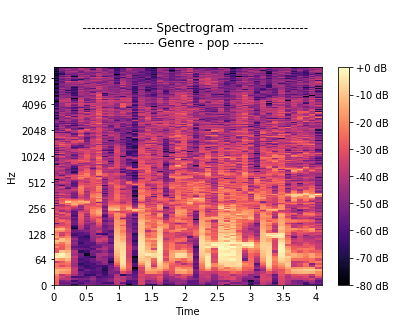

In [26]:
plot_one_map(
    spectrograms['train'][index], "spectrogram"
)

**Let's now do so for all genres, with 5 randomly sampled pieces per genre**:

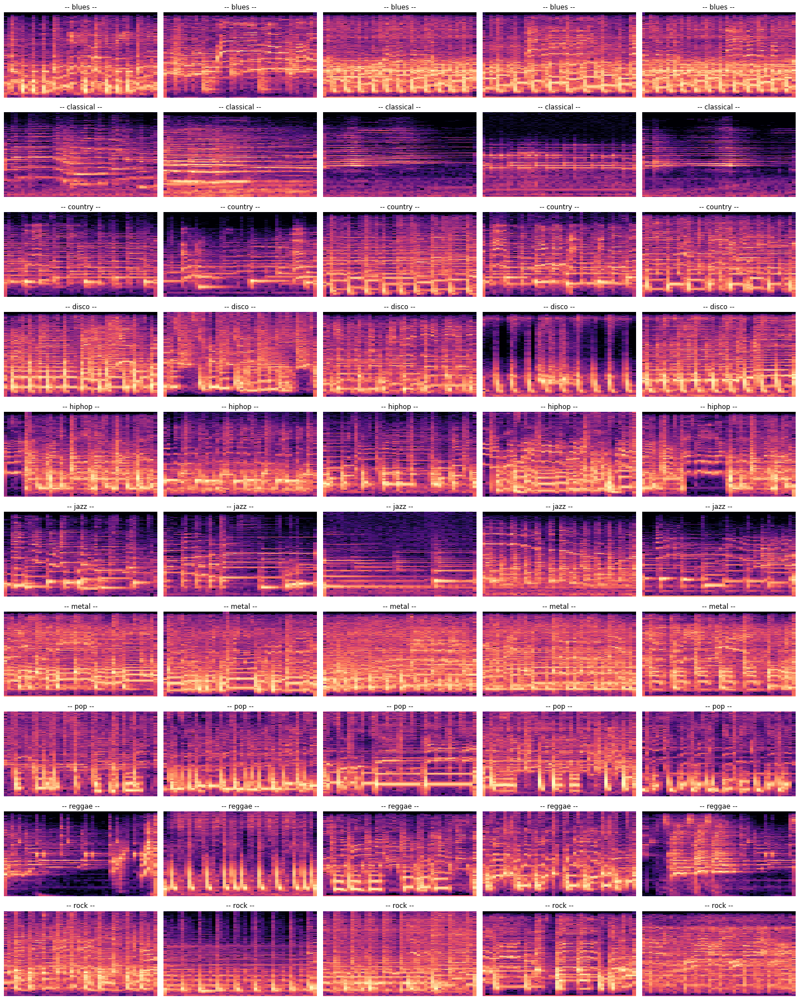

In [27]:
plot_random_maps(
    spectrograms, n_per_genre=5, map_type="spectrogram", seed=seed
)

Now classifiying these images into genres for the human eye is a completely hopeless task (although domain knowledge might significantly improve the human-baseline accuracy, it's probably still going to be very far from an audio-based classification for the human ear).

A couple noticeable aspects of the spectrogram:

- `metal` is saturated in many frequencies (high dB)
- `jazz`, `blues` and `classical` seems mostly devoid of the higher frequencies
- the `hiphop` baseline (low frequencies) stands out against the rest of the spectrum
- the `disco` low frequency beats are somewhat more apparent than other genres, at regularly-spaced intervals
- time variations for `classical` music are more seamless than other genres

The genres evoked might be easier to classify than their counterparts, that show little stand-out features so far.

## Generate the mel-maps and visualize them

In [28]:
mel_maps = generate_mel_maps_from_dict(data)

In [29]:
type(mel_maps)

dict

In [30]:
for key in mel_maps:
    print(key)

train
test


In [31]:
type(mel_maps["train"])

list

In [35]:
index = print_element(mel_maps, seed=seed)

Example:
        file_name: pop.00068.wav
        numpy_representation: [[ -8.151655   -7.7146816 -33.996597  ... -15.855284  -15.235273
  -23.85373  ]
 [-16.179016  -17.517834  -46.91674   ... -23.683788  -21.259605
  -39.168602 ]
 [-29.376238  -24.161043  -20.398172  ... -30.753464  -25.379822
  -46.149616 ]
 ...
 [-67.11942   -40.50461   -46.244553  ... -45.711834  -41.516
  -41.955532 ]
 [-67.60426   -41.8776    -44.0375    ... -50.59055   -42.184563
  -43.7698   ]
 [-66.65284   -40.73198   -41.592262  ... -42.68858   -41.482643
  -39.890648 ]]
        piece_number: 1
        genre: pop
        


In [36]:
print(f"Mel_maps shape: {mel_maps['train'][index][1].shape}")

Mel_maps shape: (40, 33)


**Now, time to visualize some mel maps: let's do so for all genres, with 5 randomly sampled pieces per genre - but first for the random mel map fetched above.**

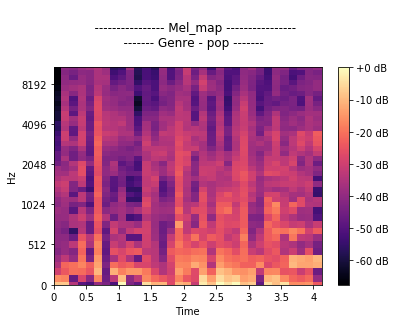

In [38]:
plot_one_map(
    mel_maps['train'][index], "mel_map"
)

#### TODO: comment

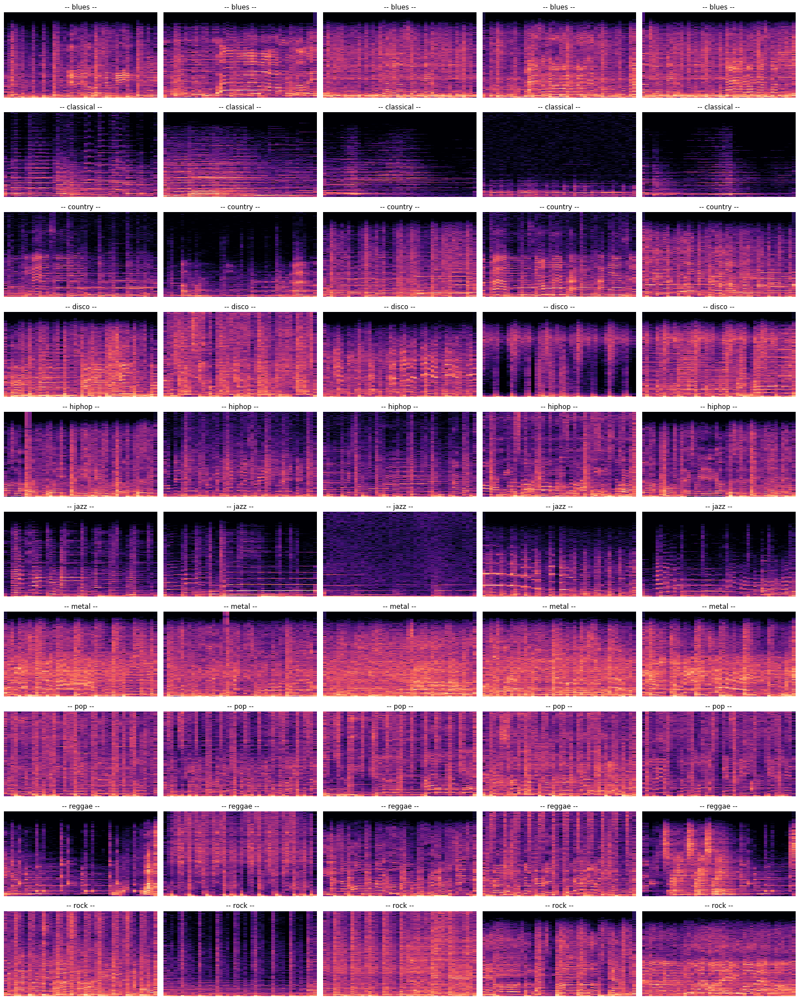

In [34]:
plot_random_maps(
    mel_maps, n_per_genre=5, map_type="mel_map", seed=seed
)

#### TODO: comment